In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
from helpers.shapedetector import ShapeDetector
from helpers.utils import *
import imutils
import cv2

import numpy as np
import re

import uiautomator2 as u2

import cv2
from PIL import Image

import skimage
from skimage import segmentation as skis

from matplotlib import pylab as plt

In [29]:
from pytesseract import Output
import pytesseract

In [4]:
d = u2.connect()

In [5]:
print(d.info)

{'currentPackageName': 'com.lge.launcher2', 'displayHeight': 1803, 'displayRotation': 0, 'displaySizeDpX': 360, 'displaySizeDpY': 640, 'displayWidth': 1080, 'productName': 'g3_global_com', 'screenOn': True, 'sdkInt': 19, 'naturalOrientation': True}


In [6]:
sess = d.session("com.nexon.kart")

/Users/rluo/anaconda3/envs/krr/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated method session. (method: session is useless now) -- Deprecated since version 3.0.0.
  """Entry point for launching an IPython kernel.


# Start page

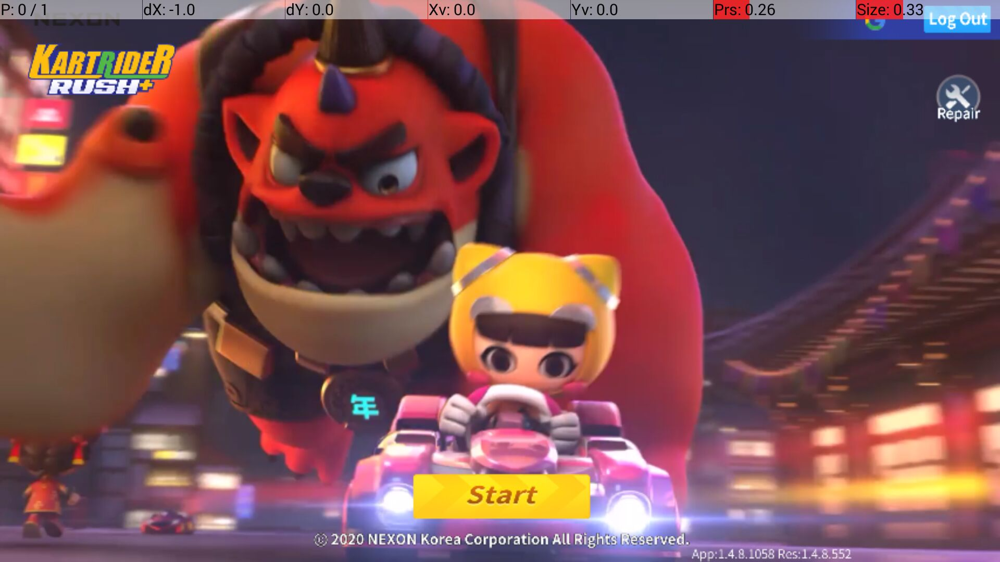

In [7]:
ss = screenshot(d, show=True, target='rgb')

In [8]:
f_seg = skis.felzenszwalb(ss, scale=500, sigma=2, min_size=100)

Text(0.5, 1.0, 'SLIC')

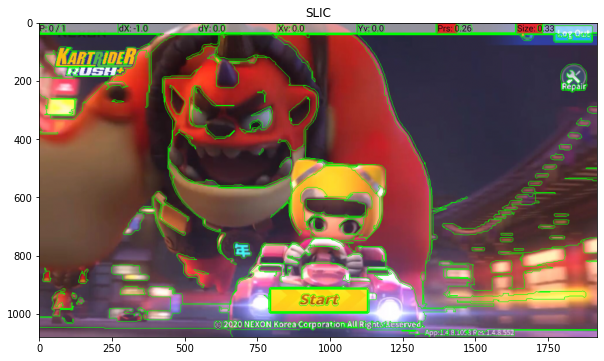

In [9]:
fig, ax = plt.subplots(figsize=(10, 10))

ax.imshow(skis.mark_boundaries(ss, f_seg, mode='thick', color=(0, 1, 0)))
ax.set_title('SLIC')

In [10]:
boundaries = (skis.find_boundaries(f_seg) * 255).astype('uint8')

In [12]:
# resize it to a smaller factor so that
# the shapes can be approximated better
resized = imutils.resize(boundaries, width=300)
ratio = ss.shape[0] / float(resized.shape[0])

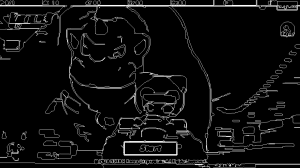

In [13]:
showimg(resized)

In [14]:
# blur it slightly,
# and threshold it
blurred = cv2.GaussianBlur(resized, (3, 3), 0)
thresh = cv2.bitwise_not(cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 3, 5))

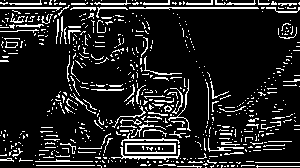

In [15]:
showimg(thresh)

In [16]:
# find contours in the thresholded image and initialize the
# shape detector
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
sd = ShapeDetector()

In [17]:
len(cnts)

616

In [18]:
img = ss.copy()
# loop over the contours
rects = []
for c in cnts:
    # compute the center of the contour, then detect the name of the
    # shape using only the contour
    if not cv2.isContourConvex(c):
        continue
    M = cv2.moments(c)
    if M["m00"] == 0:
        continue
    cX = int((M["m10"] / M["m00"]) * ratio)
    cY = int((M["m01"] / M["m00"]) * ratio)
    shape = sd.detect(c)
    # multiply the contour (x, y)-coordinates by the resize ratio,
    # then draw the contours and the name of the shape on the image
    c = c.astype("float")
    c *= ratio
    c = c.astype("int")
    cv2.drawContours(img, [c], -1, (0, 255, 0), 2)
    cv2.putText(img, shape, (cX, cY), cv2.FONT_HERSHEY_SIMPLEX,
        0.5, (255, 255, 255), 2)
#     showimg(img)
#     clear_output(wait=True)
    if shape == 'rectangle':
        rects.append(c)

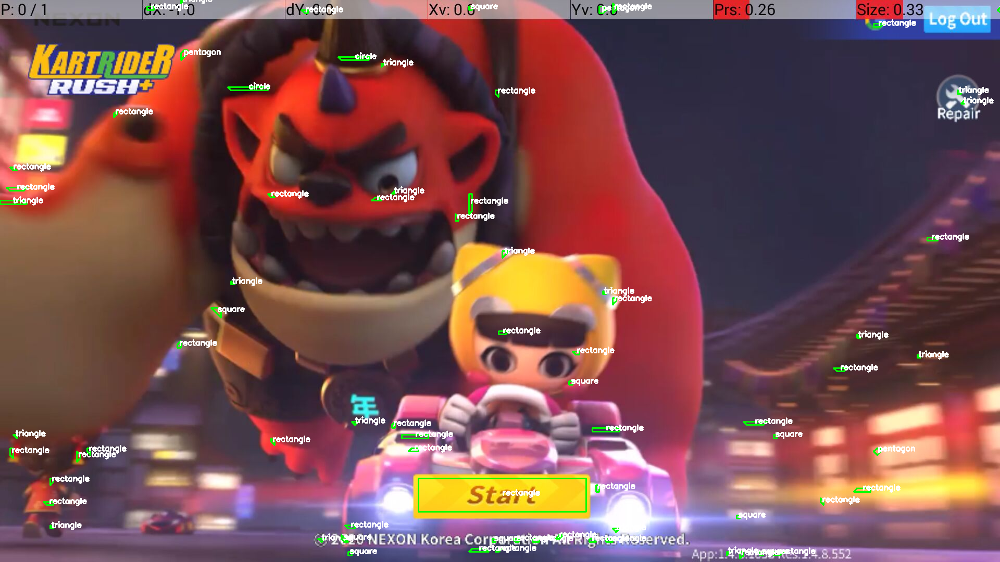

In [19]:
showimg(img)

In [20]:
sizable_boxes = []
for rect in rects:
    coor = np.squeeze(rect)
    xlocs = coor[:, 0]
    ylocs = coor[:, 1]
    w = max(xlocs) - min(xlocs)
    h = max(ylocs) - min(ylocs)
    if min(w, h) > 20:
        sizable_boxes.append(coor)

In [21]:
sizable_boxes

[array([[ 803,  919],
        [ 803,  983],
        [1125,  983],
        [1125,  919]])]

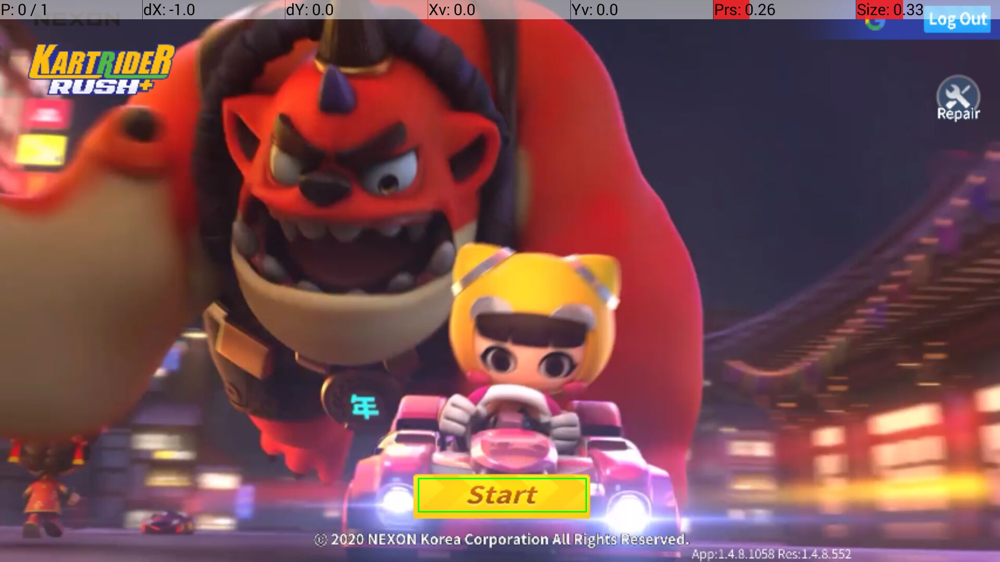

In [22]:
img = ss.copy()
# loop over the contours
for c in sizable_boxes:
    # compute the center of the contour, then detect the name of the
    # shape using only the contour
    if not cv2.isContourConvex(c):
        continue
    M = cv2.moments(c)
    cX = int((M["m10"] / M["m00"]) * ratio)
    cY = int((M["m01"] / M["m00"]) * ratio)
    cv2.drawContours(img, [c], -1, (0, 255, 0), 2)
    showimg(img)

In [25]:
coor = sizable_boxes[0]
coor

array([[ 803,  919],
       [ 803,  983],
       [1125,  983],
       [1125,  919]])

In [26]:
xmin, xmax = coor[:, 0].min(), coor[:, 0].max()
ymin, ymax = coor[:, 1].min(), coor[:, 1].max()

In [27]:
cropped = ss[ymin:ymax, xmin:xmax].copy()

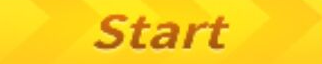

In [28]:
showimg(cropped)

In [30]:
results = pytesseract.image_to_data(cropped, output_type=Output.DICT)

In [31]:
results['text']

['', '', '', '', 'Start']

In [32]:
infer_data = results
for i in range(len(infer_data["level"])):
    conf = int(infer_data["conf"][i])
    if int(conf) < 10:
        continue

    text = infer_data["text"][i]
    text_match = re.match("^([0-9]{2}):([0-9]{2}):([0-9]{2})$", text)
#     if not text_match:
#         continue
    print(conf)

    # Visualize bbox
    (x, y, w, h) = (infer_data['left'][i], infer_data['top'][i], infer_data['width'][i], infer_data['height'][i])
    cv2.rectangle(cropped, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.putText(cropped, str(conf/100), (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)
    cv2.putText(cropped, text, (x+100, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)

96


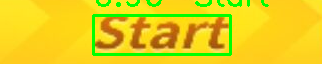

In [33]:
showimg(cropped)

In [36]:
center = coor[:, 0].mean(), coor[:, 1].mean()

In [37]:
d.long_click(*center, 1.0)

# announcement page

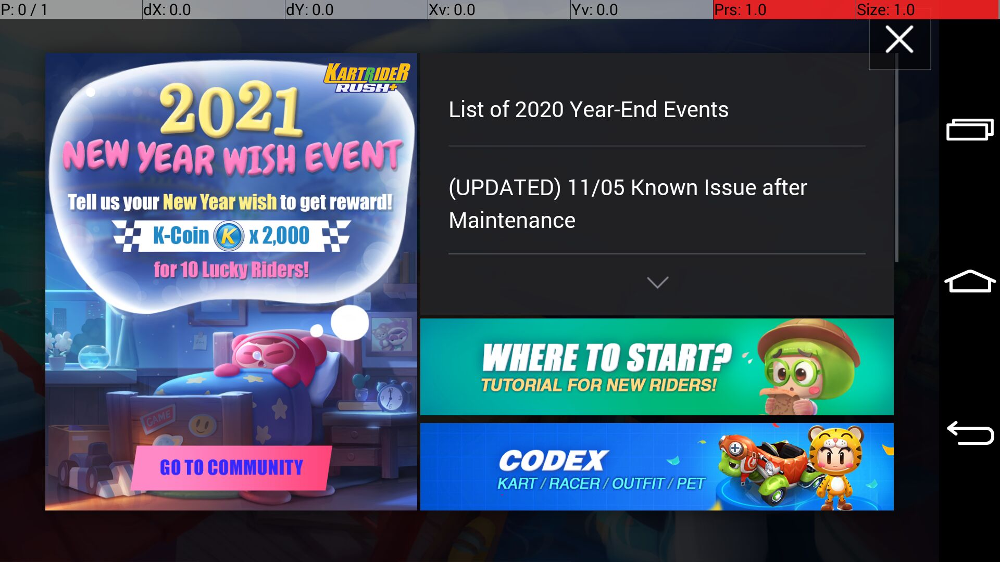

In [38]:
ss = screenshot(d, show=True, target='rgb')

In [50]:
results = pytesseract.image_to_data(ss, output_type=Output.DICT)

In [51]:
results['text']

['',
 '',
 '',
 '',
 'PO/TdX:0.0',
 'dY:',
 '0.0',
 '',
 '',
 '',
 'List',
 'of',
 '2020',
 'Year-End',
 'Events',
 '',
 '',
 '',
 '   ',
 '',
 ' ',
 '',
 '',
 '',
 '(UPDATED)',
 '11/05',
 'Known',
 'Issue',
 'after',
 '',
 'y',
 'K-Coin',
 '@',
 'Maintenance',
 '',
 '—',
 '4',
 '(an)',
 '',
 'WHERE',
 'T0',
 'START?',
 '~',
 '',
 'TUTORIAL',
 'FOR',
 'NEW',
 'RIDERS!',
 '',
 'a)',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 'GO',
 'TO',
 'COMMUNITY',
 'alae',
 'al',
 'Sane,']

In [55]:
infer_data = results
img = ss.copy()
for i in range(len(infer_data["level"])):
    conf = int(infer_data["conf"][i])
    if int(conf) < 10:
        continue

    text = infer_data["text"][i]
    text_match = re.match("^([0-9]{2}):([0-9]{2}):([0-9]{2})$", text)
#     if not text_match:
#         continue
    print(conf)

    # Visualize bbox
    (x, y, w, h) = (infer_data['left'][i], infer_data['top'][i], infer_data['width'][i], infer_data['height'][i])
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.putText(img, str(conf/100), (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)
    cv2.putText(img, text, (x+100, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)

55
55
96
96
96
96
96
95
95
95
96
96
90
96
26
82
96
67
29
32
88
72
87
46
96
96
96
96
35
95
74
74
94
34


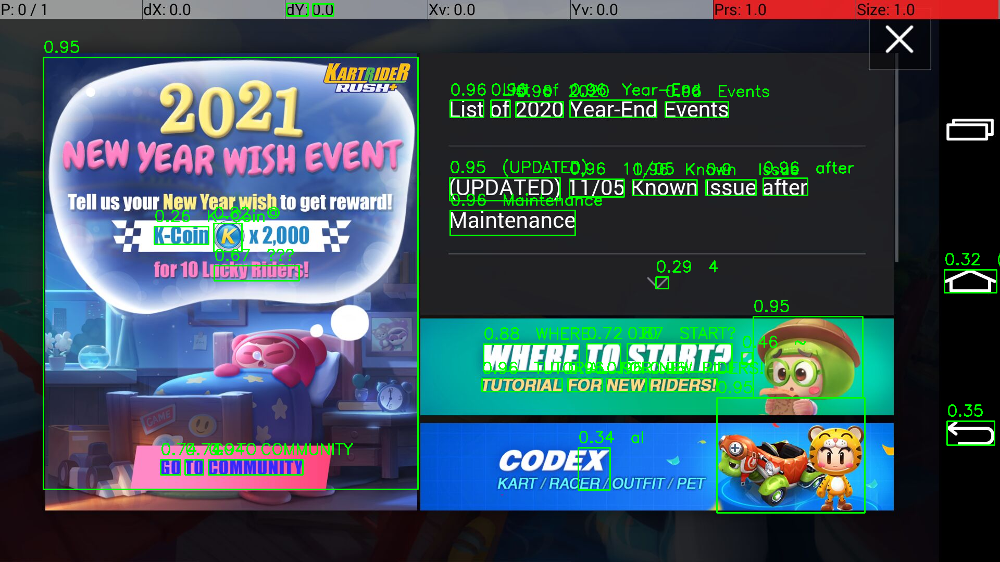

In [56]:
showimg(img)

In [57]:
d.long_click(1700, 50, 1)

<uiautomator2._Device.touch.<locals>._Touch at 0x108690110>

# signin bonus page

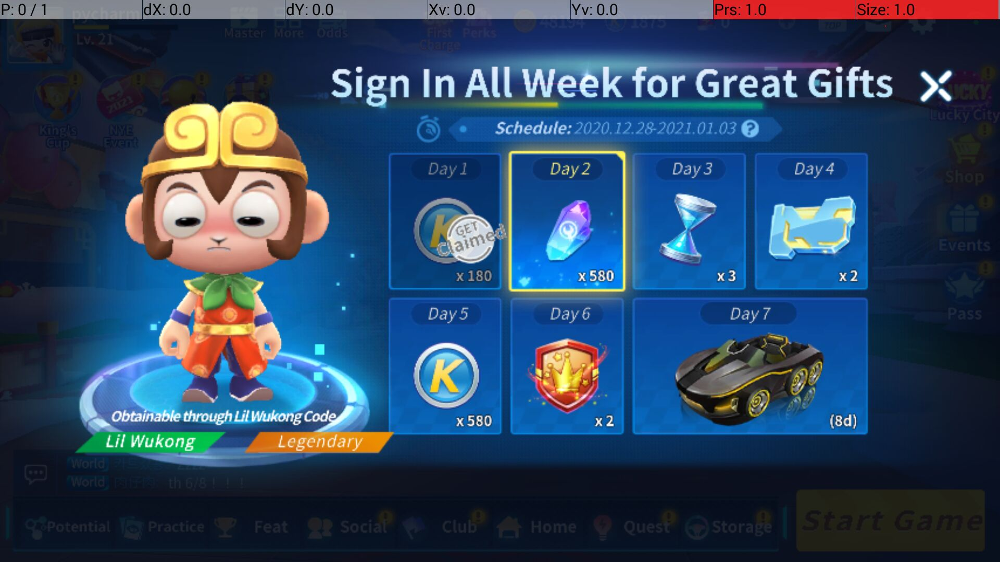

In [58]:
ss = screenshot(d, show=True, target='rgb')

In [59]:
results = pytesseract.image_to_data(ss, output_type=Output.DICT)

In [60]:
results['text']

['',
 '',
 '',
 '',
 'PO/T',
 'dX:0.0',
 'dY:',
 '0.0',
 'Xvi0.0',
 '2',
 'v.00',
 'Ps',
 '10',
 'Size:',
 '1.0',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 'Sign',
 'In',
 'All',
 'Week',
 'for',
 'Great',
 'Gifts',
 '><',
 '',
 '',
 '',
 '@)',
 '©',
 'Schedule:',
 '2020.12.28-2021.01.03',
 '@',
 '',
 '',
 '',
 ' ',
 '',
 '   ',
 '  ',
 '',
 '',
 '',
 'DESY']

In [61]:
infer_data = results
img = ss.copy()
for i in range(len(infer_data["level"])):
    conf = int(infer_data["conf"][i])
    if int(conf) < 10:
        continue

    text = infer_data["text"][i]
    text_match = re.match("^([0-9]{2}):([0-9]{2}):([0-9]{2})$", text)
#     if not text_match:
#         continue
    print(conf)

    # Visualize bbox
    (x, y, w, h) = (infer_data['left'][i], infer_data['top'][i], infer_data['width'][i], infer_data['height'][i])
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.putText(img, str(conf/100), (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)
    cv2.putText(img, text, (x+100, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)

72
85
15
35
35
66
95
94
95
96
96
95
95
95
96
96
88
50
43
80
82
95
95
95


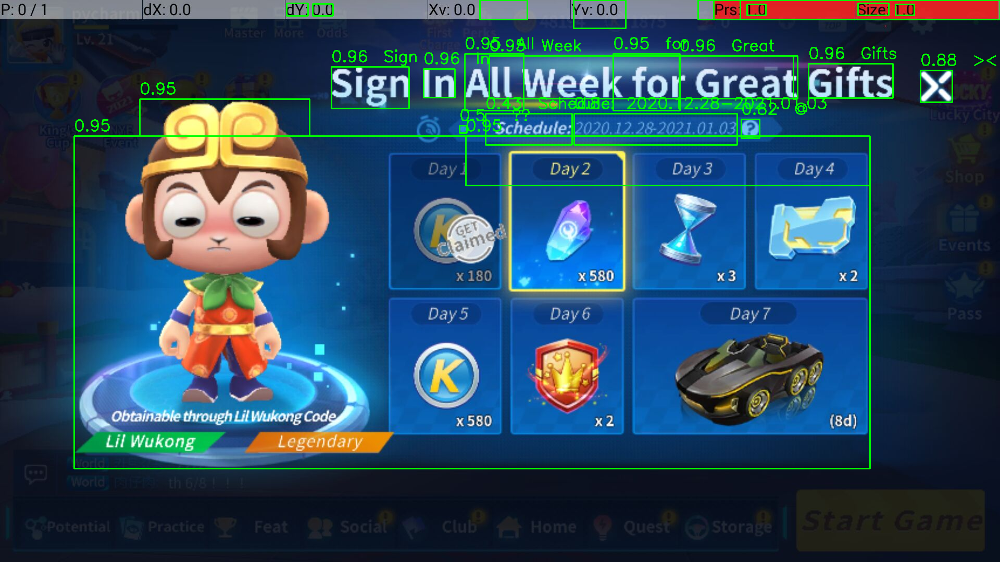

In [62]:
showimg(img)

In [69]:
d.click(1800, 175)

# events page

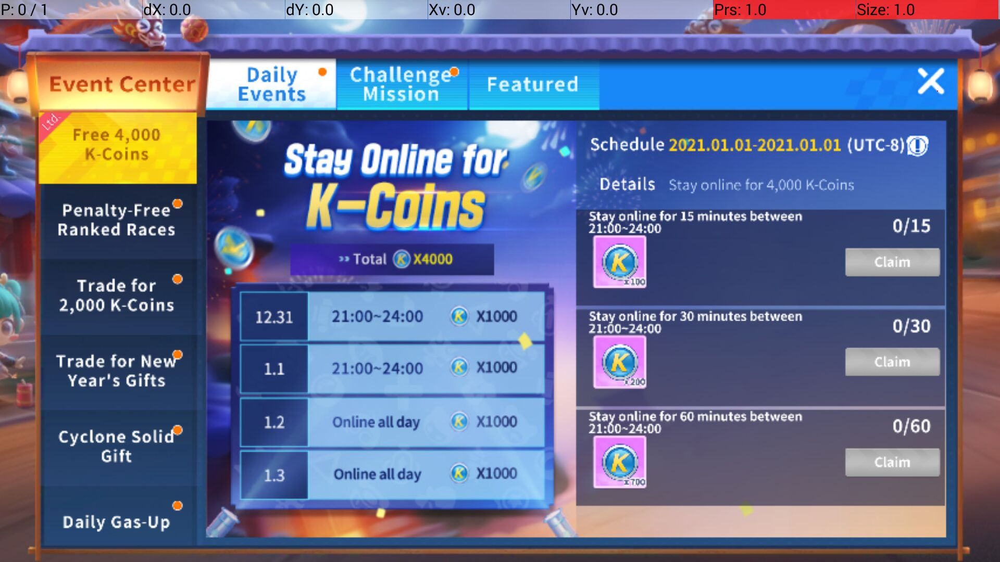

In [70]:
ss = screenshot(d, show=True, target='rgb')

In [71]:
results = pytesseract.image_to_data(ss, output_type=Output.DICT)

In [72]:
results['text']

['',
 '',
 '',
 '',
 ' ',
 '',
 ' ',
 '',
 '',
 '',
 'Y',
 'Free',
 '4,000',
 '',
 '',
 '',
 'K-Coins',
 '',
 '',
 '',
 'rae',
 'se',
 'abe',
 '',
 '',
 '',
 'Ranked',
 'Races',
 '”',
 '',
 '',
 '',
 'Tradefor',
 '®',
 '',
 '2,000',
 'K-Coins',
 '',
 '',
 '',
 'Trade',
 'for',
 'New”',
 '',
 'Nr',
 'eee',
 'cle',
 '',
 '',
 '',
 'Cyclone',
 'Solid?',
 '',
 'eth',
 'iy',
 '',
 '',
 '',
 'e',
 '',
 'Daily',
 'Gas-Up',
 'y',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 'a',
 'TT',
 'al',
 'Schedule',
 '2021.01.01-2021.01.01',
 '(UTC-',
 'Dy',
 '®',
 '',
 'Pee',
 'CMe',
 'noe',
 'att',
 'celia)',
 '',
 '4',
 'Sd',
 'A)',
 '|',
 ',',
 'Stay',
 'online',
 'for',
 '15',
 'minutes',
 'between',
 '.',
 '',
 'PSHE',
 'AUT!',
 'ype)',
 ';',
 '',
 'EO',
 '',
 '',
 '',
 '21:00~24:00',
 'Le',
 '',
 '',
 '',
 'Online',
 'all',
 'day',
 'wt',
 'ei',
 'net',
 'for',
 '60',
 'minutes',
 'between',
 '',
 '',
 '',
 'Online',
 'all',
 'day',
 '9',
 ',',
 'Le',
 '',
 'oe',
 '',
 '',
 '',
 ' ',
 '',
 '',
 '',
 '  ',

In [73]:
infer_data = results
img = ss.copy()
for i in range(len(infer_data["level"])):
    conf = int(infer_data["conf"][i])
    if int(conf) < 10:
        continue

    text = infer_data["text"][i]
    text_match = re.match("^([0-9]{2}):([0-9]{2}):([0-9]{2})$", text)
#     if not text_match:
#         continue
    print(conf)

    # Visualize bbox
    (x, y, w, h) = (infer_data['left'][i], infer_data['top'][i], infer_data['width'][i], infer_data['height'][i])
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.putText(img, str(conf/100), (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)
    cv2.putText(img, text, (x+100, y-10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)

95
95
61
94
94
90
16
27
22
96
96
23
91
85
92
90
95
95
82
22
41
96
32
48
93
92
37
95
20
28
91
91
91
49
24
16
25
10
16
26
23
31
96
96
96
96
96
96
39
23
15
91
20
70
77
80
17
23
63
96
96
96
96
96
96
96
93
18
13
95
95
95
95
95
95
95
95
72
93
60
70
90
86
42
21
24
17


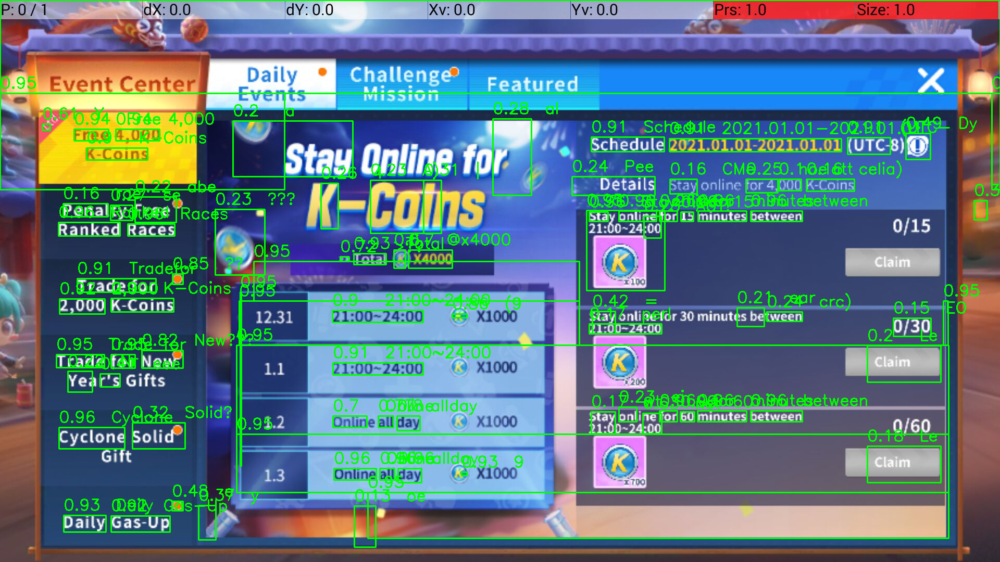

In [74]:
showimg(img)

In [75]:
d.click(1800, 175)

# charge page (?)

# home page

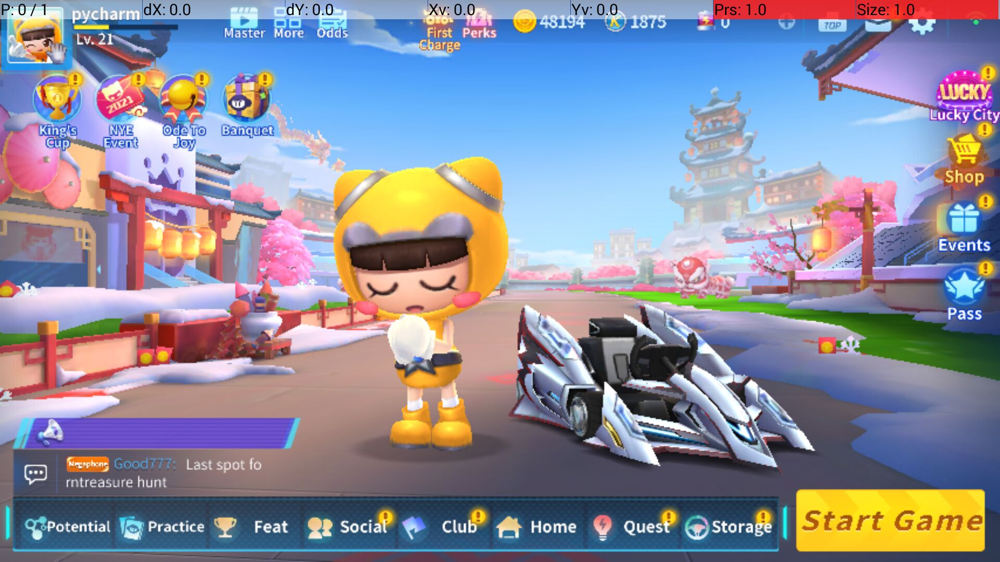

In [76]:
ss = screenshot(d, show=True, target='rgb')

In [77]:
f_seg = skis.felzenszwalb(ss, scale=500, sigma=2, min_size=100)

Text(0.5, 1.0, 'SLIC')

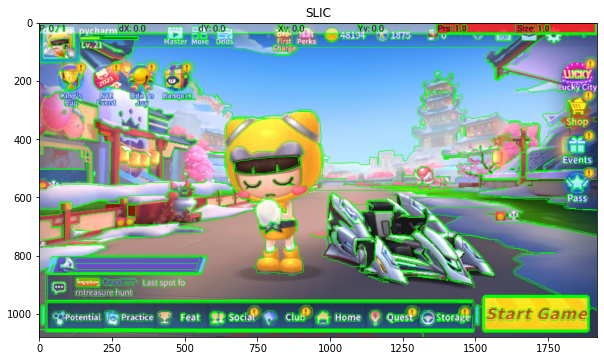

In [78]:
fig, ax = plt.subplots(figsize=(10, 10))

ax.imshow(skis.mark_boundaries(ss, f_seg, mode='thick', color=(0, 1, 0)))
ax.set_title('SLIC')

In [79]:
boundaries = (skis.find_boundaries(f_seg) * 255).astype('uint8')

In [80]:
# resize it to a smaller factor so that
# the shapes can be approximated better
resized = imutils.resize(boundaries, width=300)
ratio = ss.shape[0] / float(resized.shape[0])

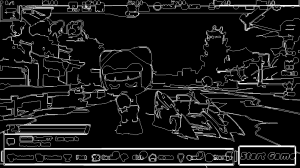

In [81]:
showimg(resized)

In [82]:
# blur it slightly,
# and threshold it
blurred = cv2.GaussianBlur(resized, (3, 3), 0)
thresh = cv2.bitwise_not(cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 3, 5))

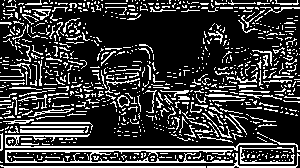

In [83]:
showimg(thresh)

In [84]:
# find contours in the thresholded image and initialize the
# shape detector
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
sd = ShapeDetector()

In [85]:
len(cnts)

805

In [86]:
img = ss.copy()
# loop over the contours
rects = []
for c in cnts:
    # compute the center of the contour, then detect the name of the
    # shape using only the contour
    if not cv2.isContourConvex(c):
        continue
    M = cv2.moments(c)
    if M["m00"] == 0:
        continue
    cX = int((M["m10"] / M["m00"]) * ratio)
    cY = int((M["m01"] / M["m00"]) * ratio)
    shape = sd.detect(c)
    # multiply the contour (x, y)-coordinates by the resize ratio,
    # then draw the contours and the name of the shape on the image
    c = c.astype("float")
    c *= ratio
    c = c.astype("int")
    cv2.drawContours(img, [c], -1, (0, 255, 0), 2)
    cv2.putText(img, shape, (cX, cY), cv2.FONT_HERSHEY_SIMPLEX,
        0.5, (255, 255, 255), 2)
#     showimg(img)
#     clear_output(wait=True)
    if shape == 'rectangle':
        rects.append(c)

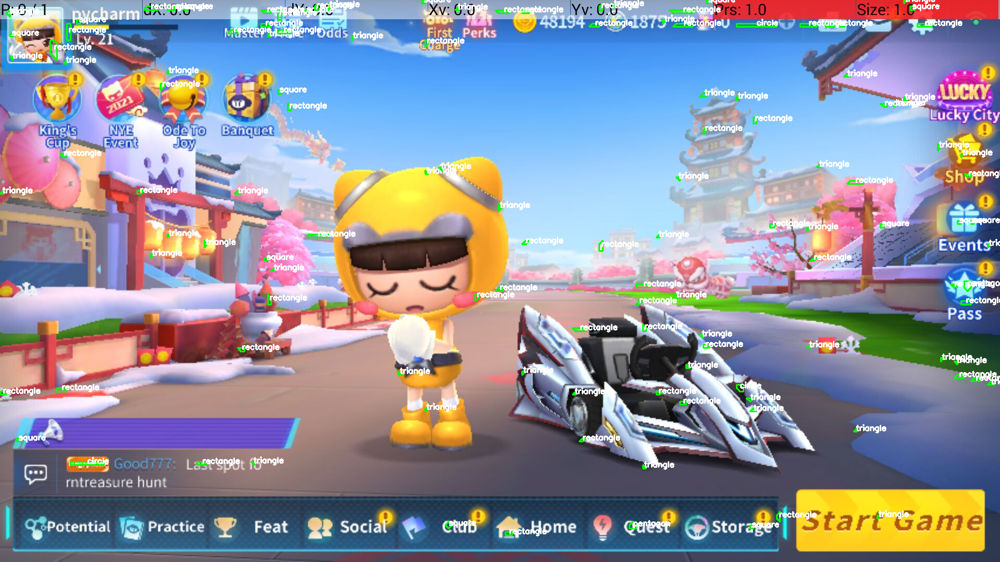

In [87]:
showimg(img)

In [20]:
sizable_boxes = []
for rect in rects:
    coor = np.squeeze(rect)
    xlocs = coor[:, 0]
    ylocs = coor[:, 1]
    w = max(xlocs) - min(xlocs)
    h = max(ylocs) - min(ylocs)
    if min(w, h) > 20:
        sizable_boxes.append(coor)

In [21]:
sizable_boxes

[array([[ 803,  919],
        [ 803,  983],
        [1125,  983],
        [1125,  919]])]

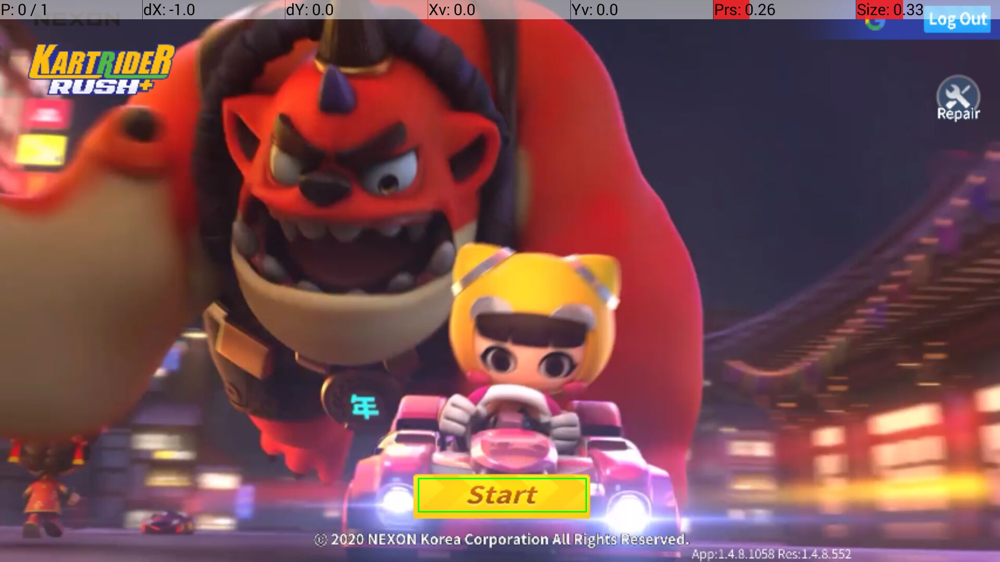

In [22]:
img = ss.copy()
# loop over the contours
for c in sizable_boxes:
    # compute the center of the contour, then detect the name of the
    # shape using only the contour
    if not cv2.isContourConvex(c):
        continue
    M = cv2.moments(c)
    cX = int((M["m10"] / M["m00"]) * ratio)
    cY = int((M["m01"] / M["m00"]) * ratio)
    cv2.drawContours(img, [c], -1, (0, 255, 0), 2)
    showimg(img)